# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

In [26]:
#Determine Business Objectives :
# The key goal is to identify key drivers for used car prices and that could help to understand what factor makes the car more or less expensive.
# The other key objective is to analyze the data and identify the most appropriate ML model that would help in generating clear recommendations to a used car dealership.


In [28]:
#Assess Situation :
# In this task the key is to use the data, here in this case we are refrrring the data from Kaggle on used cars. 
# We will be using the panda dataframe, data vsisulaization tool along with some of the data exploring technique which include data cleaning. 
# Identify the problematic scenario  that would affect the used car priice.

In [ ]:
#Determine Data minning goal:
# The goal of this task is to apply diiferent data minning technique to prepare the data releveant for builing the model. 
# This convers exploration on the data with help of different plots and compare the varaitions in the price with different feature, finding the correlation between the features and price of the used car. 
# It is needed to clean the data, remove the nosiy data and fill the missing data to use it for model building

In [ ]:
#Produce Project Plan:
# -The project covers using the used car data from Kaggle.
# This probelm is related to multiple regression model. Below are the few things that I have considered within the project scope. 
# - Perform Data explaoration 
# - Clean Data
# - Plot the data and explor different features and its correlation with price. This helps in identifying the key features
# - Use oneHotencoder for catrgorical data
# - Build different models using multiple linear regression with and without pipeline, Build model using polynomialfeature approach
# - Apply GridSearchCV to apply hyperparameter
# - Cross validation of the model and model evalutions
# - Build regression model using sequential feature
# - View coeffiient of linear regression model 
# One all the evalution is completed on Model I consider the next step and deployment approach for the model. 




### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [49]:
#Collect initial data from the data folder
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
#Read the data
vehicles_data = pd.read_csv('data/vehicles.csv')
vehicles_data.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [3]:
#Describe data to understand the data set 
vehicles_data.info()
vehicles_data.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

(426880, 18)

In [5]:
#Explore data
#Invetsiigate the data and identify the problematic data. 
#Find any null value in the dataset
print(vehicles_data.isnull().any())


id              False
region          False
price           False
year             True
manufacturer     True
model            True
condition        True
cylinders        True
fuel             True
odometer         True
title_status     True
transmission     True
VIN              True
drive            True
size             True
type             True
paint_color      True
state           False
dtype: bool


In [7]:
#Finding the count of missing values using panda and Print the data.
vehicles_missing_values = vehicles_data.isna()
vehicles_missing_count = vehicles_data.isna().sum()
print(vehicles_missing_count)
print("check if there is any duplicate row")

#Check if there is any duplicate data
vehicles_data_duplicate_rows = vehicles_data.duplicated().any()
print(vehicles_data_duplicate_rows)
vehicles_data.info()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64
check if there is any duplicate row
False
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     24920

In [9]:
#Missing values in percentage of the total samples
vehicles_data.isnull().sum() / vehicles_data.shape[0] * 100

id               0.000000
region           0.000000
price            0.000000
year             0.282281
manufacturer     4.133714
model            1.236179
condition       40.785232
cylinders       41.622470
fuel             0.705819
odometer         1.030735
title_status     1.930753
transmission     0.598763
VIN             37.725356
drive           30.586347
size            71.767476
type            21.752717
paint_color     30.501078
state            0.000000
dtype: float64

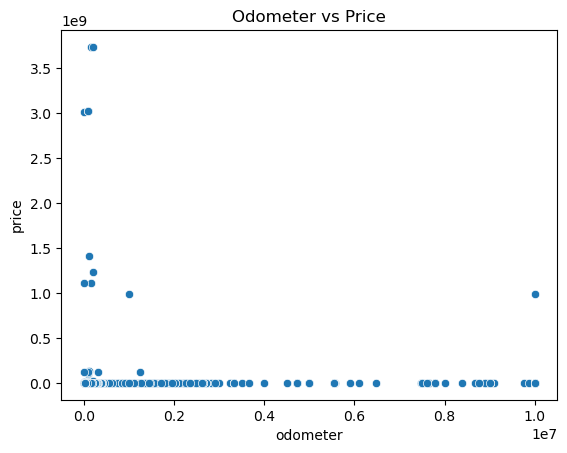

In [11]:
#Data exploration report
# Data visualization between Odeometer reading(mileage) and price of the vehicles
sns.scatterplot(data=vehicles_data, x="odometer", y="price")
plt.title('Odometer vs Price')  
plt.savefig("images/plot4.png")


#In the scatter plot we can find the Odometer data is spreaded in wide range and used car is getting costier when the odometer value is less. The dense view on the scatter plot states that.

### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [51]:
#Select and clean data

#Drop unnecessary features from the data
vehicles_data.drop(['id', 'VIN','paint_color'],axis=1, inplace=True)
#print(vehicles_data)


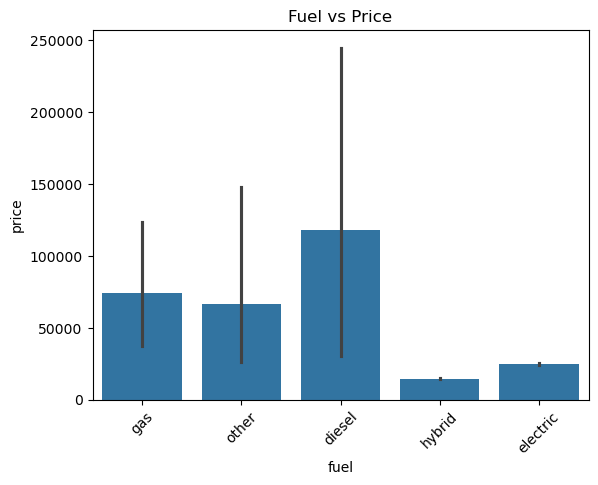

In [15]:
# Fuel vs Price plot
sns.barplot(data=vehicles_data, x="fuel", y="price")
plt.xticks(rotation = 45)
plt.title('Fuel vs Price')  
plt.savefig("images/plot5.png")
#from the graph below it is identified that diesel fuel is costiest compared to other fuel. This is an important factor.

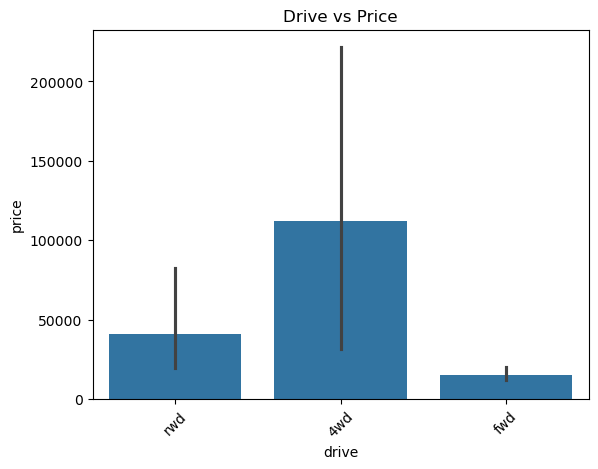

In [17]:
# Drive vs Price plot
sns.barplot(data=vehicles_data, x="drive", y="price")
plt.xticks(rotation = 45)
plt.title('Drive vs Price')  
plt.savefig("images/plot6.png")
#From the graph it is noted that (4wd)4 wheel drive is costiest compared to rear wheel car. 

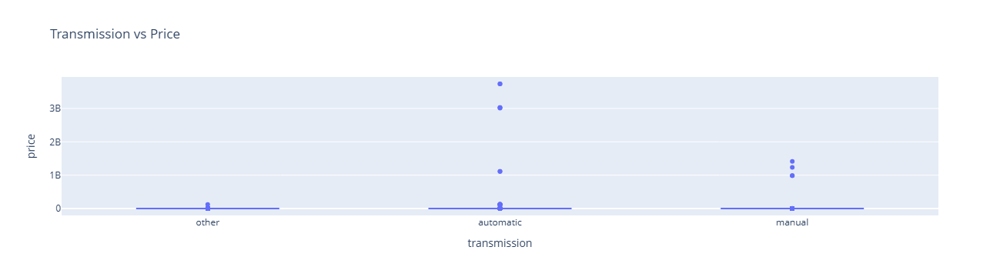

In [19]:
# Transimission vs Price plot
fig = px.box(vehicles_data, x="transmission", y="price", title="Transmission vs Price")
fig.show()
#From the graph it is noted that automatic is costiest among manual and other

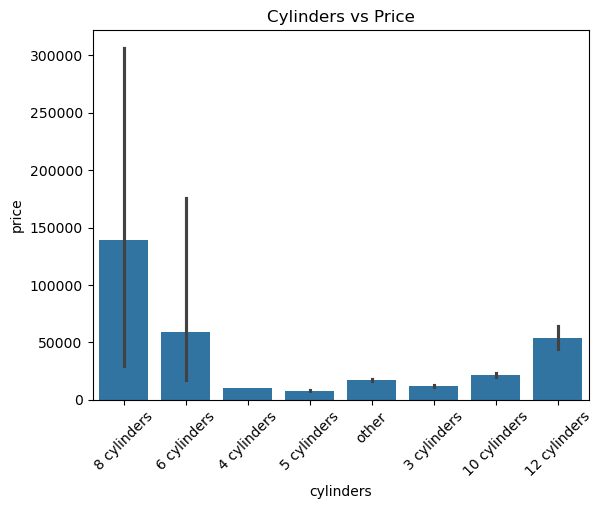

In [21]:
# Cylinders vs Price plot
#fig = px.box(vehicles_data, x="cylinders", y="price")
#fig.show()

sns.barplot(data=vehicles_data, x="cylinders", y="price")
plt.xticks(rotation = 45)
plt.title('Cylinders vs Price')  
plt.savefig("images/plot7.png")
#From the graph it is noted that 8, 6 and 12 cylinders are costiest among all. It has a impact on price.

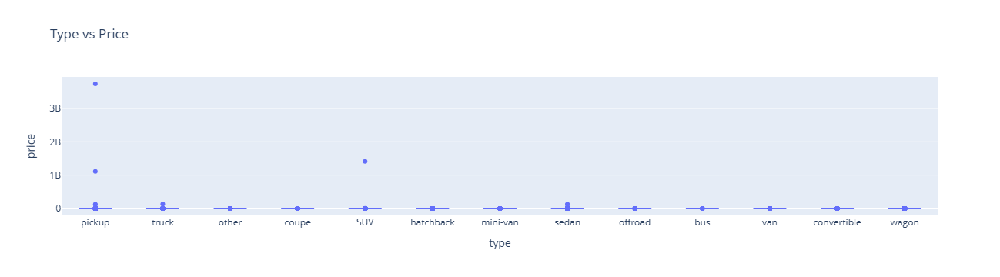

In [23]:
# Type vs Price plot
fig = px.box(vehicles_data, x="type", y="price", title="Type vs Price")
fig.show()
# The boxplot betwwen prive and type states that Pickup, sedan and SUV type used car are costiest and hence type feature has impact on used car price.

In [53]:
# drop the data for 'size' column because 70% data is missing. 
vehicles_data.drop('size',axis=1, inplace=True)

In [55]:
#Remove the car from the list purshaed before 1950 as it will have much of use.
vehicles_data = vehicles_data[vehicles_data['year']>1950]
vehicles_data.head()
#Remove some of noisy data when the car odometer is 0 miles. If the usedcar odemoter reading is 0 then it menas the car has some issue and it does not value the price
vehicles_data = vehicles_data[vehicles_data.odometer!=0]



In [57]:
# Removed some more noisy data that based on exploration. The used car which has price less than 1000USD, with manufacturing year before 2010 and odometer reading is less than 60000 are nosiy data and not relevant for pricing
vehicles_data.drop(vehicles_data[(vehicles_data.price<1000) &  (vehicles_data.odometer<60000) & (vehicles_data['year']<2010)].index, inplace=True)


In [59]:
#Dropping the data fro car used for more than 0.5 millions miles as this will noy be a valid data.
vehicles_data.drop(vehicles_data[(vehicles_data.odometer>=500000)].index, inplace=True)
print(len(vehicles_data))

420249


In [61]:
#fill missing data. Reconstruct the data
# Replacing object type column missing values with their mode and numeric type columns with their mean
vehicles_data.info()
category_columns=vehicles_data.select_dtypes(include=['object']).columns.tolist()
print(category_columns)
integer_columns=vehicles_data.select_dtypes(include=['int64','float64']).columns.tolist()
print(integer_columns)

for column in vehicles_data:
    if vehicles_data[column].isnull().any():
        if(column in category_columns):
            vehicles_data[column]=vehicles_data[column].fillna(vehicles_data[column].mode()[0])
        else:
            vehicles_data[column]=vehicles_data[column].fillna(vehicles_data[column].mean())



#vehicles_data['odometer'] = vehicles_data['odometer'].astype(float64)
vehicles_data.head()


<class 'pandas.core.frame.DataFrame'>
Index: 420249 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        420249 non-null  object 
 1   price         420249 non-null  int64  
 2   year          420249 non-null  float64
 3   manufacturer  405101 non-null  object 
 4   model         415511 non-null  object 
 5   condition     249985 non-null  object 
 6   cylinders     245371 non-null  object 
 7   fuel          417547 non-null  object 
 8   odometer      415930 non-null  float64
 9   title_status  412574 non-null  object 
 10  transmission  417806 non-null  object 
 11  drive         292764 non-null  object 
 12  type          329639 non-null  object 
 13  state         420249 non-null  object 
dtypes: float64(2), int64(1), object(11)
memory usage: 48.1+ MB
['region', 'manufacturer', 'model', 'condition', 'cylinders', 'fuel', 'title_status', 'transmission', 'drive', 'type', 'state

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,state
27,auburn,33590,2014.0,gmc,sierra 1500 crew cab slt,good,8 cylinders,gas,57923.0,clean,other,4wd,pickup,al
28,auburn,22590,2010.0,chevrolet,silverado 1500,good,8 cylinders,gas,71229.0,clean,other,4wd,pickup,al
29,auburn,39590,2020.0,chevrolet,silverado 1500 crew,good,8 cylinders,gas,19160.0,clean,other,4wd,pickup,al
30,auburn,30990,2017.0,toyota,tundra double cab sr,good,8 cylinders,gas,41124.0,clean,other,4wd,pickup,al
31,auburn,15000,2013.0,ford,f-150 xlt,excellent,6 cylinders,gas,128000.0,clean,automatic,rwd,truck,al


In [35]:
vehicles_data.describe()
#print(vehicles_data.isna().sum())

,price,year,odometer
count,4.202490e+05,420249.000000,420249.000000
mean,7.083983e+04,2011.548675,92136.654615
std,1.208452e+07,8.344480,62925.549197
min,0.000000e+00,1951.000000,1.000000
25%,5.980000e+03,2008.000000,39255.000000
50%,1.398800e+04,2014.000000,87322.000000
75%,2.649500e+04,2017.000000,133000.000000
max,3.736929e+09,2022.000000,499232.000000


In [37]:
vehicles_data.describe(include='object')

,region,manufacturer,model,condition,cylinders,fuel,title_status,transmission,drive,type,state
count,420249,420249,420249,420249,420249,420249,420249,420249,420249,420249,420249
unique,404,42,28525,6,8,5,6,3,3,13,51
top,columbus,ford,f-150,good,6 cylinders,gas,clean,automatic,4wd,sedan,ca
freq,3568,84779,12689,290728,267770,354249,407143,334773,258286,176846,49673


             price      year  odometer
price     1.000000 -0.003484  0.001429
year     -0.003484  1.000000 -0.386661
odometer  0.001429 -0.386661  1.000000


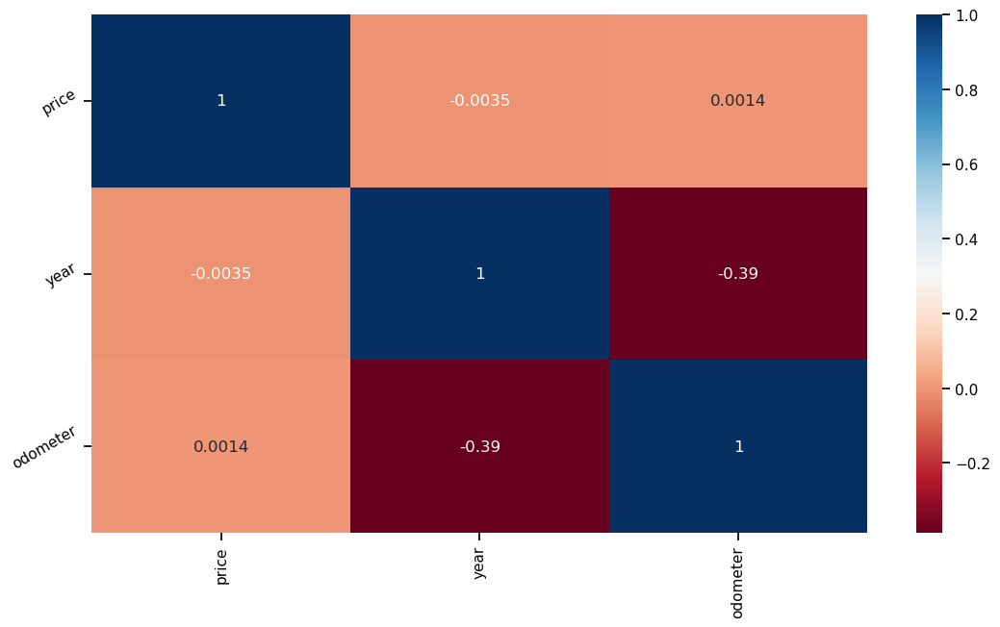

In [39]:
#Plot correlation graph
# Find highest correlation
correlation = vehicles_data.corr(numeric_only=True, method='pearson')
print(correlation)
sns.set_context("notebook", font_scale=1.0, rc={"lines.linewidth": 2.5})
plt.figure(figsize=(13,7))
a = sns.heatmap(correlation, annot=True, cmap="RdBu")
rotx = a.set_xticklabels(a.get_xticklabels(), rotation=90)
roty = a.set_yticklabels(a.get_yticklabels(), rotation=30)
# From the correlation grpah it is observed that odometer and price has stron positive correlation which menas for high odometer, the price will be larger.
# Hence odometer has highest correlation 

Text(0.5, 1.0, 'Price variation based on transmission')

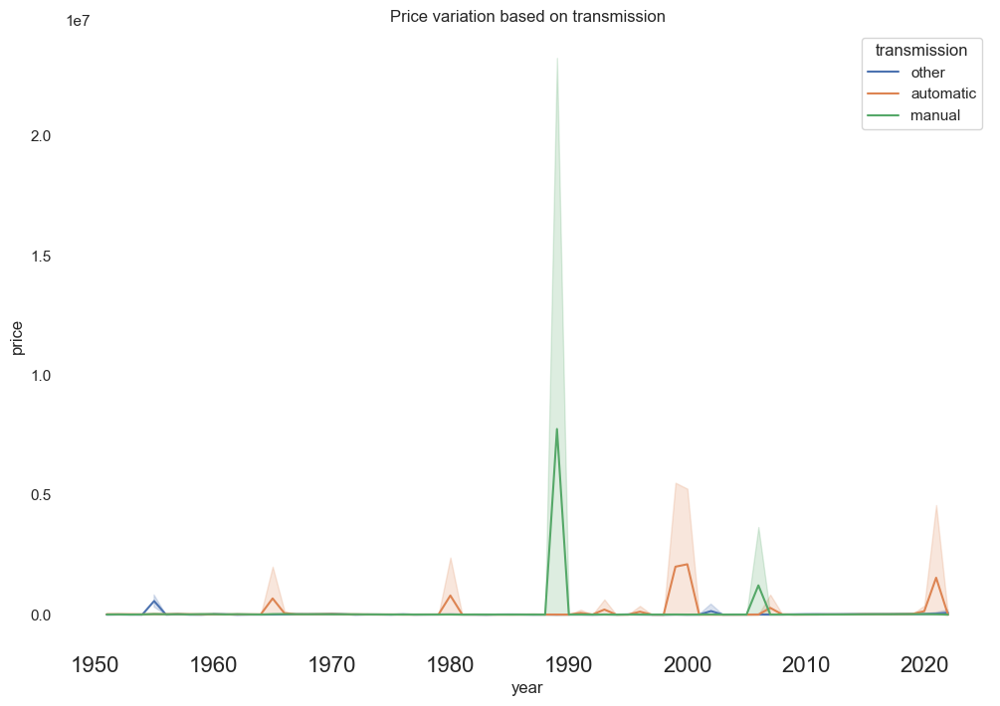

In [41]:
# We will draw lineplot between year and price. From the plot we can observe the variation in prices of cars of two transmission categories in relation to their manufacturing year.
plt.figure(figsize=(12,8))
sns.set(rc={'axes.facecolor':'white','axes.grid': True,'xtick.labelsize':16})
sns.lineplot(data=vehicles_data, x="year", y="price", hue='transmission')
plt.title('Price variation based on transmission') 

Text(0.5, 1.0, 'Price variation based on different types')

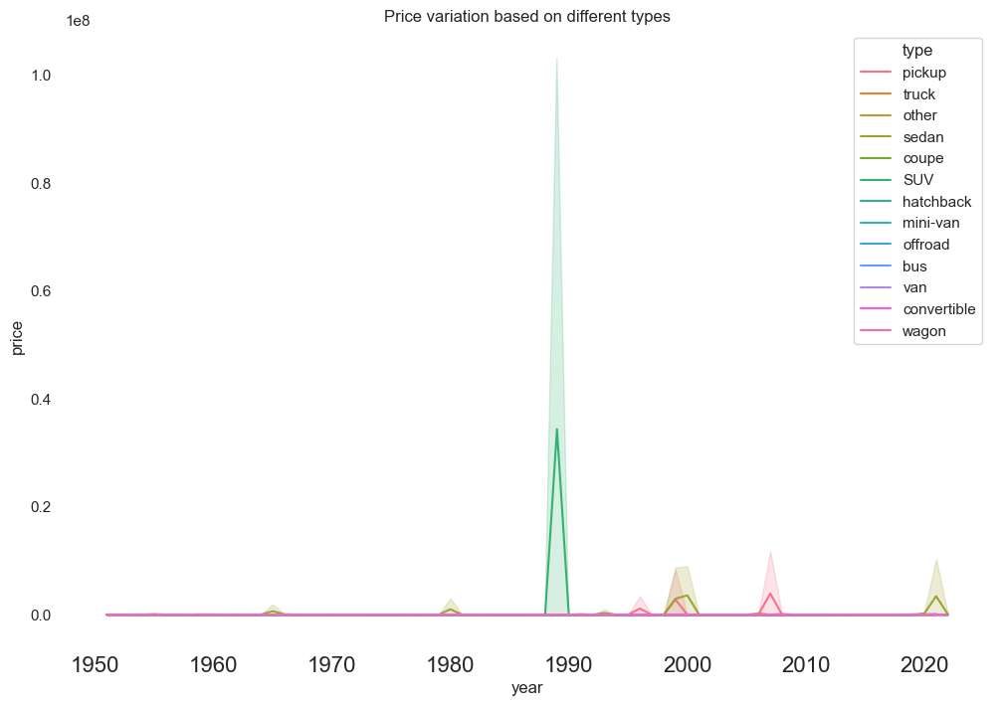

In [43]:
# From the above figure we can observe the variation in prices of cars of different types in relation to their manufacturing year.
plt.figure(figsize=(12,8))
sns.set(rc={'axes.facecolor':'white','axes.grid': True,'xtick.labelsize':16})
sns.lineplot(data=vehicles_data, x="year", y="price", hue='type')
plt.title('Price variation based on different types') 
#from the graph it is noted that type has impacted the price only in the year 1990. 

In [63]:
#Based on graphs above it is observed that the folowing features has key impacts on used car price. These features are 
# Cylinder - 8, 6 and 12 cylinders are costiest among all
# Drive - noted that (4wd)4 wheel drive is costiest compared to rear wheel car
# Transmission - noted that automatic transmission is costiest among manual and other
# Fuel - It is noted that diesel fuel is costiest compared to other fuel
# Hence will drop remaining categorical colummns only use above colums in the final data set
vehicles_data.drop(['region', 'manufacturer', 'model', 'title_status','state'],axis=1, inplace=True)

#Now we are ready with final dataset that we can use to try different modelling technique.


### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [65]:
#Looking into final data it is identified that we need to use difefrent regreession technique for the model. 
#Integrate Data
# Assigning the feature variables and the target variable
X = vehicles_data.drop('price', axis = 1)
y = vehicles_data['price']
print(vehicles_data.isna().sum())

price           0
year            0
condition       0
cylinders       0
fuel            0
odometer        0
transmission    0
drive           0
type            0
dtype: int64


In [67]:
#Split the data into training and testing Data. This will be the Generate test design for modelling. 
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=0)
print("x train: ",X_train.shape)
print("x test: ",X_test.shape)
print("y train: ",y_train.shape)
print("y test: ",y_test.shape)


x train:  (336199, 8)
x test:  (84050, 8)
y train:  (336199,)
y test:  (84050,)


In [69]:
#Scale the training and testing data 
# Scale the numeric data. it ensures that all numeric features in a dataset are on a similar scale
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
num_var = ['year', 'odometer']
X_train[num_var] = scaler.fit_transform(X_train[num_var])
X_test[num_var] = scaler.transform(X_test[num_var])

In [71]:
#After splitting and scaling the data we will look at different modeling techniques - to start with we will first teake a look at baseline preidction and calcualte mse values for training and testing
#Select modeling technique trying basline prediction
# Create Baseline prediction 
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, OrdinalEncoder
from sklearn.metrics import mean_squared_error 
from sklearn.compose import make_column_transformer, make_column_selector

from sklearn import set_config
baseline_train = ''
baseline_test = ''
mse_baseline_train = ''
mse_baseline_test = ''

baseline_train = np.ones(shape = y_train.shape)*y_train.mean()
baseline_test = np.ones(shape = y_test.shape)*y_test.mean()
mse_baseline_train = mean_squared_error(baseline_train, y_train)
mse_baseline_test = mean_squared_error(baseline_test, y_test)

print(baseline_train.shape, baseline_test.shape)
print(f'Baseline for training data: {mse_baseline_train}')
print(f'Baseline for testing data: {mse_baseline_test}')

(336199,) (84050,)
Baseline for training data: 155236648458332.1
Baseline for testing data: 109229302529960.45


In [73]:
# It is observed that the problem is related to linear regression and we will first take a look at single linear regression to compare the result.
#Another model technique using only nummeric column and use linear regression
X1 = X_train[['odometer']]
lr = LinearRegression().fit(X1, y_train)
print("model coeeficient on simgle feature")
coefficient = lr.coef_
print(coefficient)
model_1_train_mse = mean_squared_error(y_train, lr.predict(X1))
model_1_test_mse = mean_squared_error(y_test, lr.predict(X_test[['odometer']]))
### END SOLUTION

# Answer check
print(f'Train MSE: {model_1_train_mse: .2f}')
print(f'Test MSE: {model_1_test_mse: .2f}')

model coeeficient on simgle feature
[22169.79504534]
Train MSE:  155236156958519.75
Test MSE:  109230202775168.12


In [75]:
# From Correlation graph it is observed that both odometer and year has strong coorelation with price. So we will build a model using mutliple linear regression for numeric or flaot value.
# Another model technique using mutliple linser regression using multiple numeric feature.
X1_multiple = X_train[['odometer', 'year']]
lr_multiple = LinearRegression().fit(X1_multiple, y_train)
print("model coeeficient on multiple features")
coefficient_multiple = lr_multiple.coef_
print(coefficient_multiple)
model_1_train_mse_multiple = mean_squared_error(y_train, lr_multiple.predict(X1_multiple))
model_1_test_mse_multiple = mean_squared_error(y_test, lr_multiple.predict(X_test[['odometer', 'year']]))
### END SOLUTION

# Answer check
print(f'Train MSE: {model_1_train_mse_multiple: .2f}')
print(f'Test MSE: {model_1_test_mse_multiple: .2f}')

model coeeficient on multiple features
[  7474.91077711 -38023.04906154]
Train MSE:  155234927145883.47
Test MSE:  109227801290842.30


In [ ]:
#On comapring the MSE value of test data in case of linear regression on single feature and multiple linear regression we can find that multiple linear regression on numeric features has better result.

In [77]:
#Like we have stated that the problem is related to multiple linear regression so we cannot limit the multiple regression only on numeric feature. So it is important to consider non-numeric feature
# To build the meaning training for multiple linear regression using non-numeric feature we need for data preprocesing and used to convert categorical data to numeric data and have better prediction
#Another Model technique using one hot encoder one column and scalar for numeric column
ohe = OneHotEncoder(drop='first', sparse_output=False)  
ohe.fit_transform(X_train[['fuel']])

array([[0., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 1., 0., 0.],
       ...,
       [0., 1., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 0., 1.]])

In [79]:
#Here we extract the columns with object datatype as they are the categorical columns. Looking at oneHotencoding on single categorical we extended it to complete categorical column of the data.
categorical_columns=X_train.select_dtypes(include=['object']).columns.tolist()
print(categorical_columns)
ohe = OneHotEncoder(drop='first', sparse_output=False)  
ohe.fit_transform(X_train[['cylinders', 'fuel', 'transmission', 'drive']])



['condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type']


array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [83]:
#Now let's look at building a regression model with make_column_transformer and pipeline. Now we use pipeline with linear regression on multiple feature using column transform
ordinal_ohe_transformer = make_column_transformer((StandardScaler(), ['year', 'odometer']),(OneHotEncoder(drop='first', sparse_output=False), categorical_columns), remainder='passthrough')

ordinal_ohe_transformer.fit_transform(X_train)[:5]



array([[-0.90407891,  3.77573861,  0.        ,  1.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  1.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  1.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         1.        ,  0.        ,  0.        ,  0.        ],
       [ 0.53400106,  0.31794299,  0.        ,  1.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  1.        ,  0.        ,  0.        ,  0.        ,
         1.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ],
  

In [85]:
#Build pipleine using standardscaler for numeric feature and tranforming categorical column in linear regression passthrough by remainder
pipe_1 = Pipeline([('transformer', ordinal_ohe_transformer), ('scaler', StandardScaler()),
                  ('linreg', LinearRegression())])
pipe_1.fit(X_train[['condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type', 'year', 'odometer']], y_train)


Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('standardscaler',
                                                  StandardScaler(),
                                                  ['year', 'odometer']),
                                                 ('onehotencoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['condition', 'cylinders',
                                                   'fuel', 'transmission',
                                                   'drive', 'type'])])),
                ('scaler', StandardScaler()), ('linreg', LinearRegression())])

In [87]:
#Create the prediction and calcualte the MSE for taining and test data.
pred_train = pipe_1.predict(X_train[['condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type', 'year', 'odometer']])
pred_test = pipe_1.predict(X_test[['condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type', 'year', 'odometer']])

pipe_1_train_mse = mean_squared_error(y_train, pred_train)
pipe_1_test_mse = mean_squared_error(y_test, pred_test)
pipe_1_test_mse = mean_squared_error(y_test, pred_test)

print(pipe_1.named_steps)
print(f'Train MSE: {pipe_1_train_mse: .2f}')
print(f'Test MSE: {pipe_1_test_mse: .2f}')
pipe_1

{'transformer': ColumnTransformer(remainder='passthrough',
                  transformers=[('standardscaler', StandardScaler(),
                                 ['year', 'odometer']),
                                ('onehotencoder',
                                 OneHotEncoder(drop='first',
                                               sparse_output=False),
                                 ['condition', 'cylinders', 'fuel',
                                  'transmission', 'drive', 'type'])]), 'scaler': StandardScaler(), 'linreg': LinearRegression()}
Train MSE:  155216676621239.62
Test MSE:  109244858234261.72


Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('standardscaler',
                                                  StandardScaler(),
                                                  ['year', 'odometer']),
                                                 ('onehotencoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['condition', 'cylinders',
                                                   'fuel', 'transmission',
                                                   'drive', 'type'])])),
                ('scaler', StandardScaler()), ('linreg', LinearRegression())])

In [89]:
# To compare the result of different linear regression models, we will build another model with pipeline linear regression using ploynomial feature at degree 2
# In this case we only consider two categorical column - fuel and cylinder.
poly_ordinal_ohe = make_column_transformer((OneHotEncoder(drop='first', sparse_output=False), ['fuel', 'cylinders']), (PolynomialFeatures(include_bias = False, degree = 2), ['year']))

pipe_3 = Pipeline([('transformer', poly_ordinal_ohe), 
                  ('linreg', LinearRegression())])

pipe_3.fit(X_train[['year', 'fuel', 'cylinders']], y_train)

Pipeline(steps=[('transformer',
                 ColumnTransformer(transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['fuel', 'cylinders']),
                                                 ('polynomialfeatures',
                                                  PolynomialFeatures(include_bias=False),
                                                  ['year'])])),
                ('linreg', LinearRegression())])

In [91]:
#Create the prediction using polynomial degree 2 and calcualte the MSE for taining and test data.
quad_train_preds = pipe_3.predict(X_train[['year', 'fuel', 'cylinders']])
quad_test_preds = pipe_3.predict(X_test[['year', 'fuel', 'cylinders']])
quad_train_mse = mean_squared_error(y_train, quad_train_preds)
quad_test_mse = mean_squared_error(y_test, quad_test_preds)

print(f'Train MSE: {quad_train_mse: .2f}')
print(f'Test MSE: {quad_test_mse: .2f}')

Train MSE:  155232546453571.84
Test MSE:  109228686332973.38


In [ ]:
#On camparing the MSE value for pipeline linear regression with and without polynomial faeture we concluded that the we get better result with polynomial feature.
# The linear regression without pplynomial has built the model on categorical columns and linear regression on ploynomial feature with degree 2 has less MSE on test data. In model evaluation and cross validation we will explore more on polynomial feature degree to find best performance. 

In [93]:
def simple_cross_validation(X_train, y_train, X_test, y_test):
    best_pipe = None #placeholder for best model
    best_mse = np.inf #set best mse to infinity to begin
    for i in range(1, 21):
        poly_ordinal_ohe = make_column_transformer((PolynomialFeatures(degree = i), make_column_selector(dtype_include=np.float64)),
                                               (OneHotEncoder(drop='first', sparse_output=False), categorical_columns))
        pipe = Pipeline([('transformer', poly_ordinal_ohe), ('linreg', LinearRegression())])
        pipe.fit(X_train, y_train)
        test_preds = pipe.predict(X_test)
        test_mse = mean_squared_error(y_test, test_preds)
        if test_mse < best_mse:
            best_mse = test_mse
            best_pipe = pipe
    return best_pipe


best_model = simple_cross_validation(X_train, y_train, X_test, y_test)
print(best_model.get_params()) 

{'memory': None, 'steps': [('transformer', ColumnTransformer(transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=12),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A28778530>),
                                ('onehotencoder',
                                 OneHotEncoder(drop='first',
                                               sparse_output=False),
                                 ['condition', 'cylinders', 'fuel',
                                  'transmission', 'drive', 'type'])])), ('linreg', LinearRegression())], 'verbose': False, 'transformer': ColumnTransformer(transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=12),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A28778530>),
                                ('onehotencoder',
                                 OneH

In [ ]:
# Looking at the result of cross validation it is identified that for the best model the polynomial degree is 12.

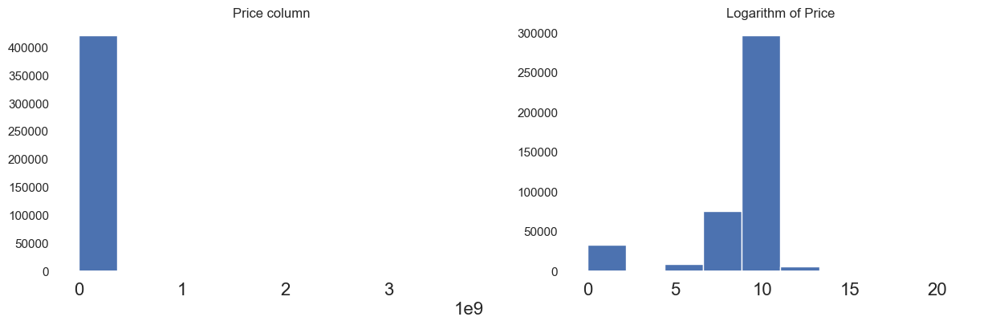

In [95]:
#Sequential feature is the key to build the model on key features instead on going over the overhead of looking into combination of model with best results. 
# let's Build Model using sequential feature selection, let's first have a plot before applying the sequential feature selection. 
# In this case we will regression models to predict the logarithm of the Price
fig, ax = plt.subplots(1, 2, figsize = (15, 4))
ax[0].hist(vehicles_data['price'])
ax[0].grid()
ax[0].set_title('Price column')
ax[1].hist(np.log1p(vehicles_data['price']))
ax[1].grid()
ax[1].set_title('Logarithm of Price');
#in the graph the logarithm chart on price display non-linear value of price over the widespread and It also explains here how the price value scale in the different range of data. 

In [196]:
#As next step we need to build polynomialfeaturee to use sequential feature selection. To start on this we need to first create a dataframe with the degree = 3 features and interaction terms added for numeric columns. 
#- Instantiate a PolynomialFeatures object for cubic features. Inside this function, set include_bias=False.
#- Use the fit_transform function on poly_features to fit and transformed the features using ['year', 'odometer']. 
#- Use the transform function on poly_features to fit and transformed the test data using ['year', 'odometer'].
#- Use the get_feature_names_out function on poly_features to extract the column names.
#- Create a DataFrame with the X_train_poly data and column names equal to column. 
#- Create a DataFrame with the X_test_poly data and column names equal to column.
#- The DataFrame train_df should look like: 

In [97]:
from sklearn.preprocessing import PolynomialFeatures
poly_features = PolynomialFeatures(degree = 3, include_bias=False)
X_train_poly = poly_features.fit_transform(X_train[['year', 'odometer']])
X_test_poly = poly_features.transform(X_test[['year', 'odometer']])
columns = poly_features.get_feature_names_out()
print(columns)
train_df = pd.DataFrame(X_train_poly, columns=columns)
test_df = pd.DataFrame(X_test_poly, columns = columns)

train_df.head()


['year' 'odometer' 'year^2' 'year odometer' 'odometer^2' 'year^3'
 'year^2 odometer' 'year odometer^2' 'odometer^3']


,year,odometer,year^2,year odometer,odometer^2,year^3,year^2 odometer,year odometer^2,odometer^3
0,-0.904079,3.775739,0.817359,-3.413566,14.256202,-0.738957,3.086133,-12.888732,53.827693
1,0.534001,0.317943,0.285157,0.169782,0.101088,0.152274,0.090664,0.053981,0.032140
2,-0.185039,2.059777,0.034239,-0.381139,4.242680,-0.006336,0.070526,-0.785061,8.738973
3,0.773681,-0.996420,0.598582,-0.770911,0.992853,0.463112,-0.596439,0.768151,-0.989298
4,0.174481,0.031180,0.030444,0.005440,0.000972,0.005312,0.000949,0.000170,0.000030


In [99]:
test_df.head()

,year,odometer,year^2,year odometer,odometer^2,year^3,year^2 odometer,year odometer^2,odometer^3
0,0.054641,0.123365,0.002986,0.006741,0.015219,0.000163,0.000368,0.000832,0.001878
1,-0.065199,-0.067101,0.004251,0.004375,0.004503,-0.000277,-0.000285,-0.000294,-0.000302
2,1.133201,-1.459889,1.284145,-1.654348,2.131276,1.455194,-1.874708,2.415164,-3.111426
3,0.653841,-0.190905,0.427508,-0.124821,0.036445,0.279522,-0.081613,0.023829,-0.006957
4,0.773681,-0.339802,0.598582,-0.262898,0.115465,0.463112,-0.203399,0.089333,-0.039235


In [101]:
#Using SequentialFeatureSelector¶
#Use the SequentialFeatureSelector function with a LinearRegression estimator to select three features (n_features_to_select = 3). 

#Use the fit_transform function on selector to train the model on train_df and y_train. 

#Finally, assign  transformed features best_features to a DataFrame. The columns of this DataFrame will be equal to selector.get_feature_names_out().
from sklearn.feature_selection import SequentialFeatureSelector
selector = SequentialFeatureSelector(LinearRegression(), n_features_to_select=3)
best_features = selector.fit_transform(train_df, y_train)
best_features_df = pd.DataFrame(best_features, columns = selector.get_feature_names_out())

best_features_df.head()

,year^3,year odometer^2,odometer^3
0,-0.738957,-12.888732,53.827693
1,0.152274,0.053981,0.032140
2,-0.006336,-0.785061,8.738973
3,0.463112,0.768151,-0.989298
4,0.005312,0.000170,0.000030


In [202]:
#After applying sequential feature we would start with building pipeline for regression model

#Create a Pipeline object with steps column_selector to select three features, and linreg to build a LinearRegression estimator. 
#Use the fit function to train pipeline using train_df and y_train.
#Use the predict function to calculate the predicitons on train_df. Assign the result on train_preds.
#Use the predict function to calculate the predicitons on test_df. Assign the result on test_preds.
#Use the mean_squared_error function to calculate the MSE between y_train and train_preds. 
#Use the mean_squared_error function to calculate the MSE between y_test and test_preds. 

In [103]:
pipe_2 = Pipeline([('column_selector', selector),
                ('linreg', LinearRegression())])
pipe_2.fit(train_df, y_train)
train_preds = pipe_2.predict(train_df)
test_preds = pipe_2.predict(test_df)
train_mse = mean_squared_error(y_train, train_preds)
test_mse = mean_squared_error(y_test, test_preds)


# Answer check
print(f'Train MSE: {train_mse: .2f}')
print(f'Test MSE: {test_mse: .2f}')
pipe_2


Train MSE:  155236308903308.75
Test MSE:  109230112770763.23


Pipeline(steps=[('column_selector',
                 SequentialFeatureSelector(estimator=LinearRegression(),
                                           n_features_to_select=3)),
                ('linreg', LinearRegression())])

In [ ]:
#Likewise we can see sequential feature selector gives us better result compared to ploynomial feature at different degree with all features. Sequential feature selction improves the performance of the model.

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In [ ]:
#In above sections we tried multiple modelling technique. Now we will evaluate the model to find the best perfomance
# We will use cross validation to check the best result
# We will use GridSearchCV to review the model performance

In [105]:
#For model evaluation let's build the predictive whole over the all features using ploynomnial feature and define the degree for the range of 1 to 8.
features = ['condition', 'cylinders', 'fuel', 'transmission', 'drive', 'type', 'year', 'odometer']
train_mses = []
test_mses = []
#for degree in 1 - 8
for i in range(1, 8):
    #create pipeline with PolynomialFeatures degree i
    poly_ordinal_ohe = make_column_transformer((PolynomialFeatures(degree = i), make_column_selector(dtype_include=np.float64)),
                                               (OneHotEncoder(drop='first', sparse_output=False), categorical_columns))
    pipe = Pipeline([('transformer', poly_ordinal_ohe), ('linreg', LinearRegression())])

    pipe.fit(X_train[features], y_train)
    #fit on train
    train_predict_p1 = pipe.predict(X_train[features])
    test_predict_p2 = pipe.predict(X_test[features])
    #predict on train and test
    train_mses.append(mean_squared_error(y_train, train_predict_p1))
    test_mses.append(mean_squared_error(y_test, test_predict_p2))

best_model_complexity = test_mses.index(min(test_mses)) + 1

print(train_mses)
print(test_mses)
pipe
print(best_model_complexity)

[155216676621239.62, 155213831268558.84, 155210262129818.84, 155207840313060.8, 155207197114194.5, 155206585479812.16, 155203751741968.28]
[109244858234261.72, 109244673002909.66, 109245872708130.23, 109241922371476.72, 109239625582967.69, 109239768135470.23, 109244631002427.69]
5


In [ ]:
# As we can see the with the given range the best model degree for polynomial feature is identfied at degree 5.

The Complexity that minimized Test Error was: 5


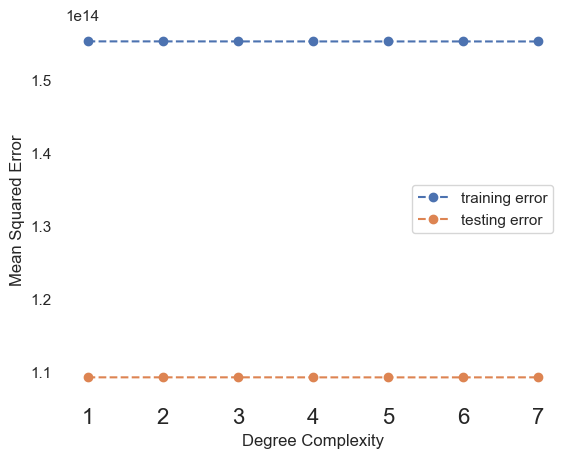

In [107]:
# We wiill use the plot to display the evalution of result and explian the model complexity.
print(f'The Complexity that minimized Test Error was: {test_mses.index(min(test_mses)) + 1}')
plt.plot(range(1, 8), train_mses, '--o', label = 'training error')
plt.plot(range(1, 8), test_mses, '--o', label = 'testing error')
plt.xticks(range(1, 8), range(1, 8))
plt.xlabel('Degree Complexity')
plt.ylabel('Mean Squared Error')
plt.legend();

In [109]:
#To confirm the result of model derived using polynomial feature degree we would like to perform simple cross valdiation. 

def simple_cross_validation(X_train, y_train, X_test, y_test):
    best_pipe = None #placeholder for best model
    best_mse = np.inf #set best mse to infinity to begin
    for i in range(1, 21):
        poly_ordinal_ohe = make_column_transformer((PolynomialFeatures(degree = i), make_column_selector(dtype_include=np.float64)),
                                               (OneHotEncoder(drop='first', sparse_output=False), categorical_columns))
        pipe = Pipeline([('transformer', poly_ordinal_ohe), ('linreg', LinearRegression())])
        pipe.fit(X_train, y_train)
        test_preds = pipe.predict(X_test)
        test_mse = mean_squared_error(y_test, test_preds)
        if test_mse < best_mse:
            best_mse = test_mse
            best_pipe = pipe
    return best_pipe


best_model = simple_cross_validation(X_train, y_train, X_test, y_test)
print(best_model.get_params()) 

{'memory': None, 'steps': [('transformer', ColumnTransformer(transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=12),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A2C29FE60>),
                                ('onehotencoder',
                                 OneHotEncoder(drop='first',
                                               sparse_output=False),
                                 ['condition', 'cylinders', 'fuel',
                                  'transmission', 'drive', 'type'])])), ('linreg', LinearRegression())], 'verbose': False, 'transformer': ColumnTransformer(transformers=[('polynomialfeatures',
                                 PolynomialFeatures(degree=12),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A2C29FE60>),
                                ('onehotencoder',
                                 OneH

In [113]:
#Evaluate results
#GridSearchCV to search over different hyperparameter values within the Ridge estimator. acts as a valuable tool for identifying the optimal parameters for a machine learning model
# GridSeearchCV allows to find hyper parameter to enhance the model performance.
from sklearn.model_selection import  train_test_split, GridSearchCV
from sklearn.linear_model import Ridge


In [ ]:
poly_ordinal_ohe = make_column_transformer((PolynomialFeatures(degree = 2), make_column_selector(dtype_include=np.float64)),
                                               (OneHotEncoder(drop='first', sparse_output=False), categorical_columns))

ridge_pipe = Pipeline([('transformer', poly_ordinal_ohe),
    ('ss', StandardScaler()),
    ('pf', PolynomialFeatures(degree=2, include_bias=False)),
    ('ridge', Ridge())])

print(ridge_pipe.get_params())

#to search over hyperparameters you have to create a dictionary with a key whose name is exactly that of the hyperparameter to search over. With the Ridge estimator, this will be alpha

ridge_pipe_params = {'ridge__alpha':[0.001, 0.01, 0.1, 0, 1, 10]}

gs_ridge_pipe = GridSearchCV(estimator=ridge_pipe, param_grid=ridge_pipe_params)
gs_ridge_pipe.fit(X_train, y_train)

print(gs_ridge_pipe.best_params_)


print(gs_ridge_pipe.score(X_train, y_train))
print(gs_ridge_pipe.score(X_test, y_test))


{'memory': None, 'steps': [('transformer', ColumnTransformer(transformers=[('polynomialfeatures', PolynomialFeatures(),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A3B808D70>),
                                ('onehotencoder',
                                 OneHotEncoder(drop='first',
                                               sparse_output=False),
                                 ['condition', 'cylinders', 'fuel',
                                  'transmission', 'drive', 'type'])])), ('ss', StandardScaler()), ('pf', PolynomialFeatures(include_bias=False)), ('ridge', Ridge())], 'verbose': False, 'transformer': ColumnTransformer(transformers=[('polynomialfeatures', PolynomialFeatures(),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x0000024A3B808D70>),
                                ('onehotencoder',
                                 OneHotEncoder(drop='first'

In [ ]:
#We can see from above result that GridSearchCV helped in identifying the best hyper parameter in case ridge regression and this can build using ridge alpha value as 10

In [ ]:
#Determine next steps
# For future steps we need to look at the deployment plan for the model
# The current process can be improved if we try sequential feature selection for non-numeric feature and try to build model using the sequntial feature selection on non-numeric model
# Other possible improvement can be made by trying K fold cross validation to have more better performance. 

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.

In [ ]:
#Plan deployment
#For the model deployment the key is to define a relevant infrastructure and system configuration. 
#This may involve choosing appropriate hardware or cloud platforms, installing servers, and guaranteeing the scalability and dependability of the deployment environment.
#The relevant version of software should be installed in the infrastrcuture.

In [ ]:
#Model Integration:
#Models need to integrate with the existing software ecosystem. This often involves developing APIs or connectors to foster communication between models and other systems

In [ ]:
#Plan monitoring and maintenance
#Once deployed, models need continuous monitoring to ensure they perform as expected. This includes tracking metrics,identifying issues,and re-training models when new data is available or when specifications change.

In [ ]:
#Scalability: 
#Deployment should be scalable to handle growing workloads and data volumes, depending on the anticipated usage. 
#This often involves load balancing and resource management

In [ ]:
#Produce final report
#This is the final written report of the data mining engagement. It includes all of the previous deliverables,
#summarizing and organizing the results.
#Following are the key technique used in Data minning are similar to what was stated in Data minning goal. 
# Data cleaning, Fiiling Misisng Data and Finding relation between the features that are key driver for increase in proce of used cars and using diferent techniques to build model and compare it with best resuults.